In [29]:
from huggingface_hub import from_pretrained_keras
from PIL import Image

import tensorflow as tf
import numpy as np
import requests

image_path = '/home/sl237/COMP646_Project/selectively_diffused_image.jpg'
# url = "https://github.com/sayakpaul/maxim-tf/blob/main/images/Deblurring/input/109fromGOPR1096.MP4.png?raw=true"
# image = Image.open(requests.get(url, stream=True).raw)
image = Image.open(image_path).convert("RGB")
image = np.array(image)
image = tf.convert_to_tensor(image)
image = tf.image.resize(image, (256, 256))

model = from_pretrained_keras("google/maxim-s3-deblurring-reds")
predictions = model.predict(tf.expand_dims(image, 0))


ModuleNotFoundError: No module named 'tensorflow'

In [1]:
import torch
import torchvision.transforms as T
from PIL import Image
from torchvision.models import vgg19
from kornia.filters import GaussianBlur2d

# This function will attempt to deblur the image using a sharpening filter after blurring it slightly.
def deblur_image(image_path):
    # Load the image
    image = Image.open(image_path).convert("RGB")

    # Transform the image to tensor
    transform = T.Compose([
        T.ToTensor(),
    ])
    image_tensor = transform(image).unsqueeze(0)  # Add batch dimension

    # Apply a small Gaussian blur
    gaussian_blur = GaussianBlur2d((3, 3), (1.5, 1.5))
    blurred_image = gaussian_blur(image_tensor)

    # Using a pre-trained VGG19 model as a feature extractor
    vgg = vgg19(pretrained=True).features

    # The following steps would involve setting up a deblurring network
    # that takes as input the blurred image and outputs a deblurred image.
    # This would require additional code and a pre-trained deblurring network.
    # Since this is not available here, the following line is a placeholder.
    # deblurred_image = deblurring_network(blurred_image)

    # Since we do not actually have a `deblurring_network`, let's just return the blurred image.
    # In a real scenario, the deblurred image would be the output of the model.
    return blurred_image.squeeze()  # Remove batch dimension for visualization

# Image file path
image_path = '/home/sl237/COMP646_Project/7391713650294_.pic.jpg'

# Deblur the image (Placeholder operation)
deblurred_image_tensor = deblur_image(image_path)

# Convert the tensor to PIL Image for visualization
deblurred_image = T.ToPILImage()(deblurred_image_tensor)

# Save or display the deblurred image
deblurred_image.show()


/home/sl237/.conda/envs/ltsm/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


ImportError: /home/sl237/.conda/envs/ltsm/lib/python3.10/site-packages/flash_attn_2_cuda.cpython-310-x86_64-linux-gnu.so: undefined symbol: _ZN2at4_ops5zeros4callEN3c108ArrayRefINS2_6SymIntEEENS2_8optionalINS2_10ScalarTypeEEENS6_INS2_6LayoutEEENS6_INS2_6DeviceEEENS6_IbEE

In [7]:
import torch
from diffusers import StableDiffusionPipeline
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model_id = "stabilityai/stable-diffusion-2-1"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype = dtype)
pipe = pipe.to(device)

Loading pipeline components...: 100%|██████████| 6/6 [00:13<00:00,  2.33s/it]


In [11]:
print(pipe.vae)

AutoencoderKL(
  (encoder): Encoder(
    (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (down_blocks): ModuleList(
      (0): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0-1): 2 x ResnetBlock2D(
            (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
            (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
            (dropout): Dropout(p=0.0, inplace=False)
            (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (nonlinearity): SiLU()
          )
        )
        (downsamplers): ModuleList(
          (0): Downsample2D(
            (conv): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2))
          )
        )
      )
      (1): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0): ResnetBlock2D(
            (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
            (c

torch.Size([1, 3, 534, 800])


In [15]:
encoded_latents.__dict__


{'latent_dist': <diffusers.models.autoencoders.vae.DiagonalGaussianDistribution at 0x7f018d3ca500>}

torch.Size([1, 3, 534, 800])


/tmp/ipykernel_2984607/3440307286.py:67: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 2, figsize=(12, 6))


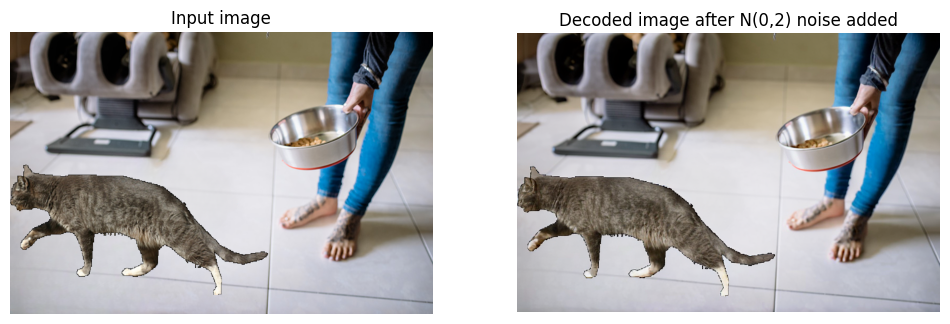

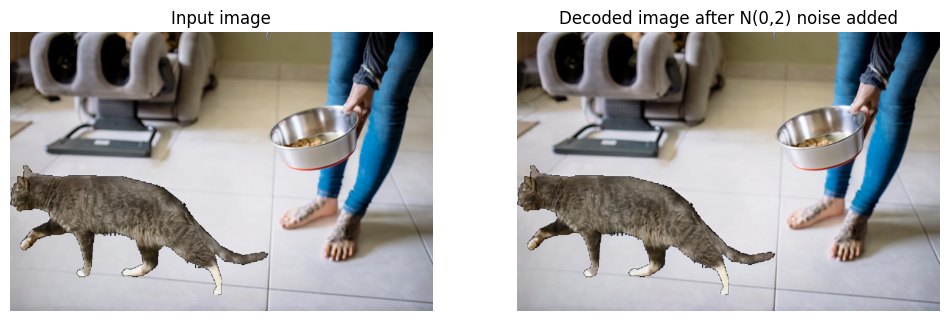

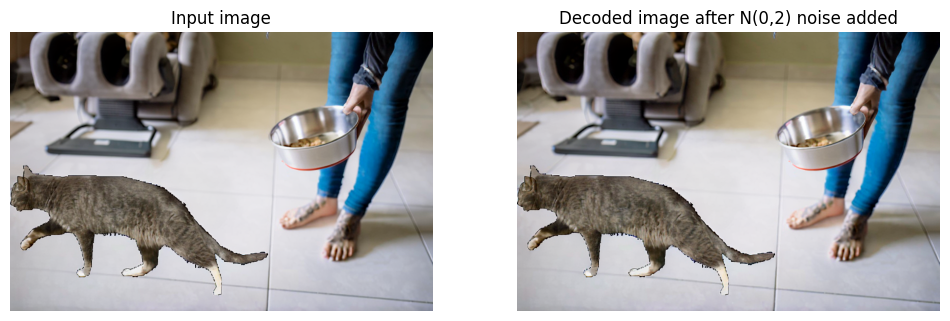

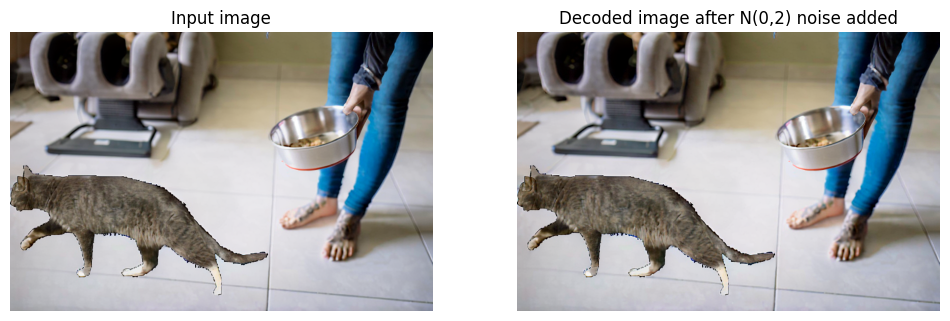

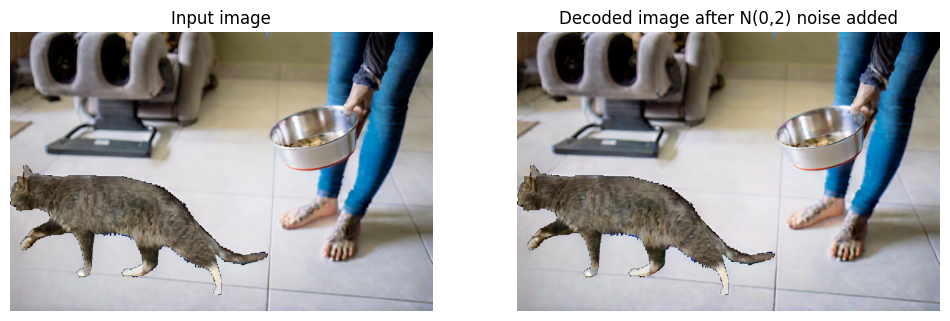

...

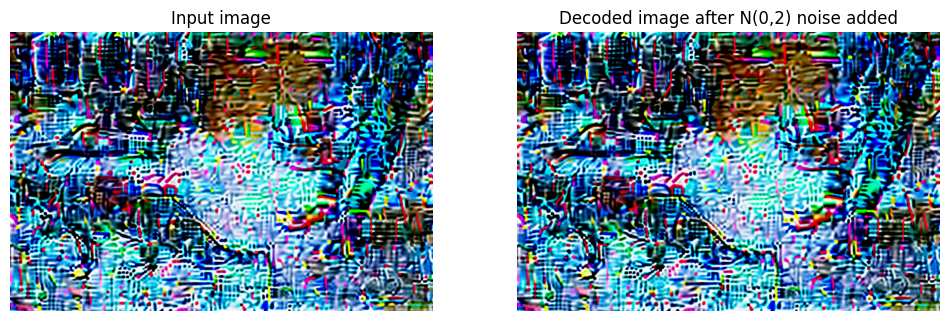

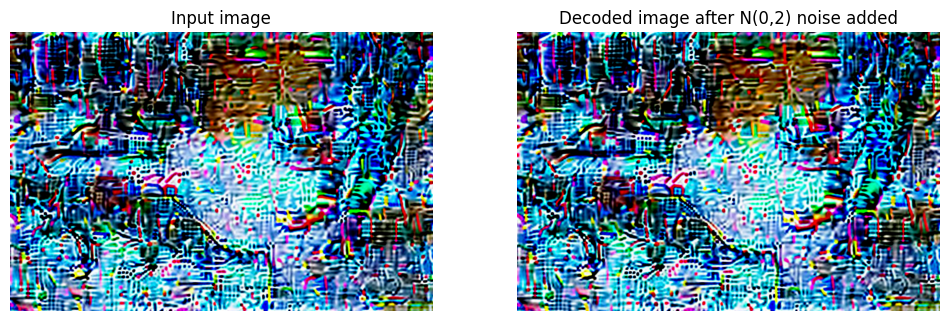

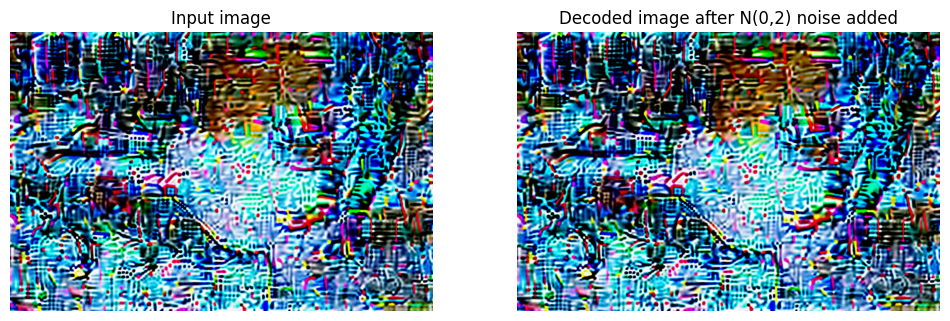

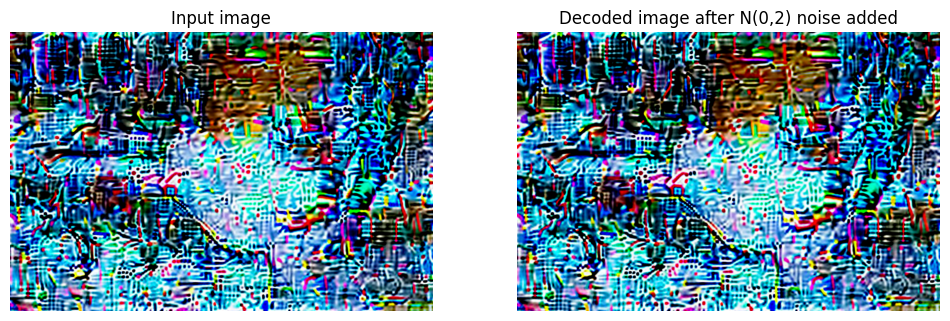

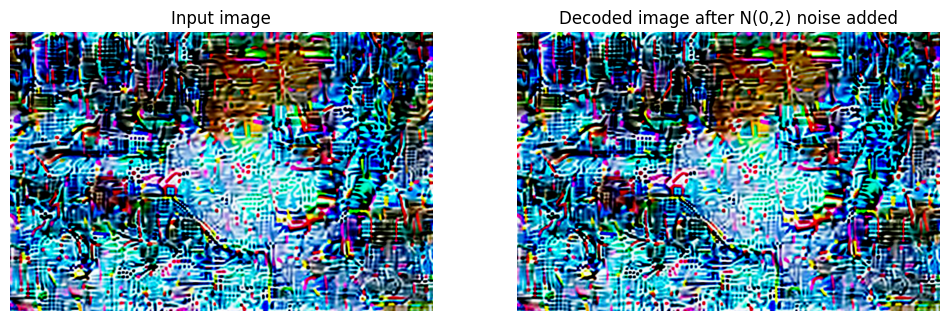

In [28]:
import io, requests
from PIL import Image
import torchvision.transforms as transforms
import matplotlib.pyplot as plt

from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize, ConvertImageDtype
import torch
from diffusers import StableDiffusionPipeline


from torchvision.transforms.functional import to_pil_image
dtype=torch.float16
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
# Use this image I took from a trip to the Galapagos.
image_path = '/home/sl237/COMP646_Project/7181713648089_.pic.jpg'
# image = Image.open(io.BytesIO(response.content))
image = Image.open(image_path).convert("RGB")

# Your code goes here.

# Normalize image
transform = Compose([
    ToTensor(),
])
transformed_image = transform(image).unsqueeze(0).to(device)
print(transformed_image.shape)
transformed_image = transformed_image.to(dtype)

for i in range(50):

    # Input to encoder
    with torch.no_grad():
        encoded_latents = pipe.vae.encode(transformed_image).latent_dist.sample()

    # print(encoded_latents.shape)


    # # referenced the source code of Stable Diffusion 2.1, it use a quant_conv and a post_quant_conv to process the encoder output and decoder input
    # # (https://github.com/Stability-AI/stablediffusion/blob/main/ldm/models/autoencoder.py#L84)
    # moments = pipe.vae.quant_conv(encoded_latents)

    # # take the first 4 channels as input of decoder (it achieves a better performance after experiments)
    # memo = moments[:,:4,:,:]

    # # add random gaussian noise centered at zero with a standard deviation of 2.0 to the latent space
    # posterior = torch.randn(memo.shape, device=device, dtype=dtype) * 2.0 + memo

    # # as mentioned beore, referenced the source code of AutoEncoderKL of Stable Diffusion
    # # (https://github.com/Stability-AI/stablediffusion/blob/main/ldm/models/autoencoder.py#L89)
    # decoder_input = pipe.vae.post_quant_conv(posterior)

    # Fix: Remove extra dimensions from the image tensor


    # Input in decoder
    with torch.no_grad():
        # decoded_images = pipe.vae.decoder(decoder_input).cpu()
        decoded_images = pipe.vae.decode(encoded_latents)

    # decoded_images=  decoded_images.squeeze()
    # Visualize the images
    image_tensor = torch.clamp(decoded_images[0][0], 0, 1)
    image_pil = to_pil_image(image_tensor)
    transformed_image_tensor = torch.clamp(transformed_image[0], 0, 1)
    itransformed_image_pil = to_pil_image(transformed_image_tensor)

    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(itransformed_image_pil)
    ax[0].set_title('Input image')
    ax[0].axis('off')

    ax[1].imshow(image_pil)
    ax[1].set_title('Decoded image after N(0,2) noise added')
    ax[1].axis('off')

    transformed_image = decoded_images[0]


In [9]:
from PIL import Image
import torch
import torch.nn.functional as F
import numpy as np

# Load the image from file
img_path = '/home/sl237/COMP646_Project/7181713648089_.pic.jpg'
smoothed_img_path = '/home/sl237/COMP646_Project/71.jpg'
img = Image.open(img_path)

kernel_size = 5
stride = 1
# Convert the image to a tensor
img_tensor = torch.from_numpy(np.array(img)).permute(2, 0, 1).float()
# Re-adjust the tensor dimensions and types for the pooling operation
img_tensor = img_tensor.to(torch.float32)  # Ensure the tensor is in float32 for the AvgPool operation

# Check if image tensor needs to be normalized (having pixel values between 0 and 1)
if img_tensor.max() > 1.0:
    img_tensor /= 255.0

# Apply AvgPool2d with kernel size 3, stride 1, and padding 1 to maintain the original image size
smoothed_img_tensor = F.avg_pool2d(img_tensor, kernel_size, stride, padding=1)

# Convert the smoothed tensor back to a PIL image with proper scaling
smoothed_img = Image.fromarray((smoothed_img_tensor.squeeze(0).permute(1, 2, 0).clamp(0, 1) * 255).byte().numpy())

# Save the smoothed image again
smoothed_img.save(smoothed_img_path)

# Display the smoothed image
smoothed_img.show()
